### **Descripción Lagrangiana del Problema**

El sistema consiste en $ N $ partículas que se mueven dentro de un túnel horizontal de longitud $ L $ y altura $ H $
. Cada partícula tiene una posición definida por su vector de posición $$\mathbf{r}_i(t) = (x_i(t), y_i(t))$$
donde $ i = 1, 2, \dots, N $, y una velocidad $\mathbf{v}_i(t) = (v_{x,i}(t), v_{y,i}(t))$. Las partículas interactúan entre sí mediante colisiones elásticas y con las paredes del túnel según las siguientes reglas:

#### **Ecuaciones de Movimiento**
En ausencia de fuerzas externas (como la gravedad o fricción), las partículas se mueven con velocidad constante entre colisiones. La evolución temporal de la posición y la velocidad de cada partícula está dada por:
$$
\frac{d\mathbf{r}_i}{dt} = \mathbf{v}_i(t),
$$
$$
\frac{d\mathbf{v}_i}{dt} = 0 \quad \text{(sin fuerzas externas)}.
$$

#### **Condiciones de Colisión**
1. **Colisión con las paredes del túnel**:
   - Si una partícula toca la pared inferior ($y_i = 0$), su velocidad se anula: $\mathbf{v}_i(t) = 0.$
   - Si una partícula toca la pared superior ($y_i = H$), su velocidad en $y$ cambia de signo:$v_{y,i}(t^+) = -v_{y,i}(t^-).$
   - Si una partícula toca las paredes laterales ($x_i = 0$ o $x_i = L$), su velocidad en $x$ cambia de signo:$v_{x,i}(t^+) = -v_{x,i}(t^-).$

2. **Colisión entre partículas**:
   Cuando dos partículas $i$ y $j$ colisionan (es decir, cuando la distancia entre ellas es menor que el diámetro efectivo $d$):
   - Se conserva la cantidad de movimiento lineal:
     $$
     m_i \mathbf{v}_i + m_j \mathbf{v}_j = m_i \mathbf{v}_i' + m_j \mathbf{v}_j',
     $$
   - Se conserva la energía cinética total:
     $$
     \frac{1}{2}m_i |\mathbf{v}_i|^2 + \frac{1}{2}m_j |\mathbf{v}_j|^2 = 
     \frac{1}{2}m_i |\mathbf{v}_i'|^2 + \frac{1}{2}m_j |\mathbf{v}_j'|^2.
     $$
   Estas condiciones determinan las velocidades después de la colisión ($\mathbf{v}_i'$ y $\mathbf{v}_j'$).

#### **Restricciones del Sistema**
- El movimiento está restringido al dominio del túnel: $ 0 \leq x_i(t) \leq L, 0 \leq y_i(t) \leq H$.
- Si una partícula toca la pared inferior ($y_i = 0$), se detiene completamente.

---

### **Lagrangiano del Sistema**

El lagrangiano para cada partícula $i$ está dado por: $L_i = T_i - V_i,$ donde:

·) $ T_i = \frac{1}{2}m_i |\mathbf{v}_i|^2 = \frac{1}{2}m_i (v_{x,i}^2 + v_{y,i}^2) $ es la energía cinética.

·) $ V_i = 0$, ya que no hay fuerzas externas actuando sobre las partículas.

El lagrangiano total del sistema es simplemente la suma de los lagrangianos individuales:
$$
L_{\text{total}} = \sum_{i=1}^{N} L_i.
$$

Dado que no hay fuerzas externas ni potenciales, las ecuaciones de Euler-Lagrange para cada coordenada simplemente recuperan las ecuaciones del movimiento rectilíneo uniforme:
$$
\frac{\partial L}{\partial x_i} - \frac{d}{dt}\left(\frac{\partial L}{\partial v_{x,i}}\right) = 0, 
\quad
\frac{\partial L}{\partial y_i} - \frac{d}{dt}\left(\frac{\partial L}{\partial v_{y,i}}\right) = 0.
$$

# Conexión entre la Descripción Lagrangiana y la Implementación del Código

## 1. Ecuaciones de Movimiento

**Teoría Lagrangiana:**
Las ecuaciones de movimiento para cada partícula \( i \) son:

$$
\frac{d\mathbf{r}_i}{dt} = \mathbf{v}_i(t)
$$

$$
\frac{d\mathbf{v}_i}{dt} = 0 \quad \text{(sin fuerzas externas)}
$$




Esta línea actualiza las posiciones de todas las partículas simultáneamente. Es una implementación numérica de la integración de la velocidad en el tiempo, equivalente a resolver:

$$
\mathbf{r}_i(t+dt) = \mathbf{r}_i(t) + \mathbf{v}_i(t) \cdot dt
$$

La segunda ecuación (\( d\mathbf{v}_i/dt = 0 \)) se implementa implícitamente al no modificar las velocidades excepto durante las colisiones.

---

## 2. Condiciones de Colisión

### a) Colisiones con las paredes

**Teoría Lagrangiana:**
- Pared inferior (\( y_i = 0 \)): \( \mathbf{v}_i(t) = 0 \)
- Pared superior (\( y_i = H \)): \( v_{y,i}(t^+) = -v_{y,i}(t^-) \)
- Paredes laterales: \( v_{x,i}(t^+) = -v_{x,i}(t^-) \)



Estas líneas implementan exactamente las condiciones de colisión descritas en la teoría, usando máscaras booleanas para aplicar las reglas a todas las partículas que cumplen las condiciones simultáneamente.

---

### b) Colisiones entre partículas

**Teoría Lagrangiana:**
Conservación del momento lineal y la energía cinética:

$$
m_i \mathbf{v}_i + m_j \mathbf{v}_j = m_i \mathbf{v}_i' + m_j \mathbf{v}_j'
$$

$$
\frac{1}{2}m_i |\mathbf{v}_i|^2 + \frac{1}{2}m_j |\mathbf{v}_j|^2 =
\frac{1}{2}m_i |\mathbf{v}_i'|^2 + \frac{1}{2}m_j |\mathbf{v}_j'|^2
$$





Este fragmento implementa la colisión elástica entre dos partículas. La conservación del momento y la energía se garantiza al intercambiar las componentes normales de las velocidades relativas.

---

## 3. Restricciones del Sistema

**Teoría Lagrangiana:**
El movimiento está restringido al dominio del túnel:

$$
0 \leq x_i(t) \leq L, \quad 0 \leq y_i(t) \leq H
$$

**Implementación en el código:**
Las restricciones se implementan a través de las condiciones de colisión con las paredes y la eliminación de partículas que salen del dominio:




---

## 4. Lagrangiano del Sistema

**Teoría Lagrangiana:**

El lagrangiano para cada partícula está dado por:

$$
L_i = T_i - V_i, 
$$

donde:
- \( T_i = \frac{1}{2}m_i |\mathbf{v}_i|^2 = \frac{1}{2}m_i (v_{x,i}^2 + v_{y,i}^2) \): energía cinética.
- \( V_i = 0 \): no hay fuerzas externas actuando sobre las partículas.

El lagrangiano total es simplemente la suma de los lagrangianos individuales:

$$
L_{\text{total}} = \sum_{i=1}^{N} L_i.
$$

Aunque el código no calcula explícitamente el Lagrangiano, el movimiento de las partículas sigue las ecuaciones derivadas de este Lagrangiano:

1. Movimiento rectilíneo uniforme entre colisiones (implementado en la actualización de posiciones).
2. Conservación de la energía en colisiones elásticas (implementado en la lógica de colisiones).

---

## Conexión con la Simulación

El código implementa un método de integración numérica simple (método de Euler) para resolver las ecuaciones de movimiento:

1. **Actualización del movimiento libre:** Las posiciones se actualizan basándose en las velocidades actuales:


In [ ]:
all_positions += all_velocities * dt


2. **Colisiones con paredes:** Las partículas interactúan con las paredes según reglas específicas:
- Se detienen al tocar la pared inferior.
- Rebotan al tocar la pared superior.
- Salen del dominio al cruzar el límite derecho.

3. **Colisiones entre partículas:** Se manejan mediante conservación del momento lineal y energía cinética:



4. **Restricciones geométricas:** Las partículas permanecen dentro del dominio definido por el túnel gracias a las condiciones de colisión.

Esta implementación captura la esencia del sistema Lagrangiano descrito, modelando el movimiento libre entre colisiones y aplicando las reglas de conservación durante las interacciones, todo dentro de un dominio restringido.


Animation size has reached 20991263 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


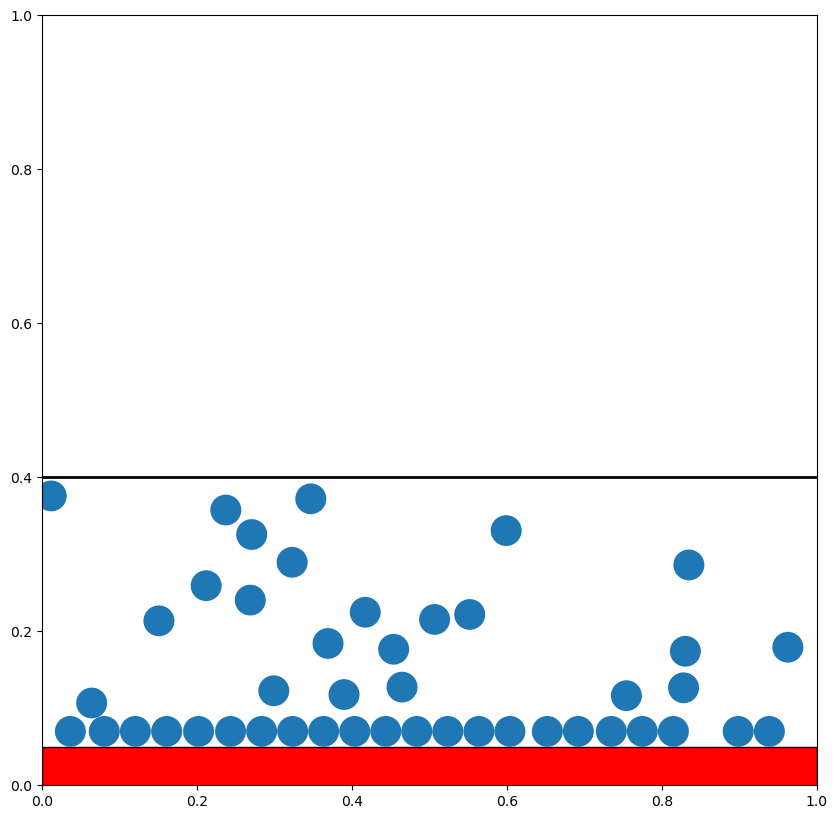

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Circle, Rectangle
from IPython.display import HTML

# Parámetros de la simulación
num_rows = 10
num_cols = 50
n_sets = 1
u_0 = 0.1
dt = 0.05
steps = 2000
radius = 0.02
top_wall_height = num_rows * 2 * radius

# Cálculo del periodo de entrada
entry_period = int((num_cols * 2 * radius) / (u_0 * dt))

# Nueva pared horizontal
wall_y = 0
wall_thickness = 0.1
wall_start_x = 0
wall_end_x = 1.0
sticky_wall = True # Parámetro para controlar si la pared es adhesiva

def create_particle_group():
    positions = np.zeros((num_rows * num_cols, 2))
    velocities = np.zeros((num_rows * num_cols, 2))
    for col in range(num_cols):
        for row in range(num_rows):
            idx = col * num_rows + row
            positions[idx, 0] = -2 * radius * (num_cols - col)
            positions[idx, 1] = row * 2 * radius + radius
            velocities[idx, 0] = u_0
    return positions, velocities

all_positions = []
all_velocities = []

def handle_collisions(positions, velocities):
    N = len(positions)
    for i in range(N):
        # Colisión con paredes
        if positions[i, 1] <= radius:  # Pared inferior
            positions[i, 1] = radius
            velocities[i] = [0, 0]
        elif positions[i, 1] >= top_wall_height - radius:  # Pared superior
            positions[i, 1] = top_wall_height - radius
            velocities[i, 1] *= -1
        if positions[i, 0] >= 1 - radius:  # Pared derecha (salida)
            positions[i] = [-1, -1]
            velocities[i] = [0, 0]
        
        # Colisión con la nueva pared horizontal
        if wall_start_x <= positions[i, 0] <= wall_end_x and \
           wall_y - wall_thickness/2 - radius <= positions[i, 1] <= wall_y + wall_thickness/2 + radius:
            if sticky_wall:
                positions[i, 1] = wall_y + wall_thickness/2 + radius
                velocities[i] = [0, 0]  # Se pega a la pared
            else:
                if positions[i, 1] < wall_y:
                    positions[i, 1] = wall_y - wall_thickness/2 - radius
                else:
                    positions[i, 1] = wall_y + wall_thickness/2 + radius
                velocities[i, 1] *= -1  # Rebote elástico

        # Colisiones entre partículas
        for j in range(i+1, N):
            if positions[i, 0] < 0 or positions[j, 0] < 0:
                continue
            diff = positions[i] - positions[j]
            dist = np.linalg.norm(diff)
            if dist < 2*radius:
                overlap = 2*radius - dist
                positions[i] += overlap/2 * diff/dist
                positions[j] -= overlap/2 * diff/dist

                normal = diff / dist
                v_rel = velocities[i] - velocities[j]
                v_normal = np.dot(v_rel, normal) * normal
                velocities[i] -= v_normal
                velocities[j] += v_normal

    mask = positions[:, 0] < 1
    return positions[mask], velocities[mask]

fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)

particles = []
wall = Rectangle((wall_start_x, wall_y - wall_thickness/2), wall_end_x - wall_start_x, wall_thickness, 
                 facecolor='red', edgecolor='black')
ax.add_patch(wall)

top_wall = plt.Line2D([0, 1], [top_wall_height, top_wall_height], color='black', linewidth=2)
ax.add_line(top_wall)

def update(frame):
    global all_positions, all_velocities, particles
    
    if frame % entry_period == 0 and len(all_positions) < n_sets:
        new_positions, new_velocities = create_particle_group()
        all_positions.append(new_positions)
        all_velocities.append(new_velocities)
    
    for i in range(len(all_positions)):
        all_positions[i] += all_velocities[i] * dt
        all_positions[i], all_velocities[i] = handle_collisions(all_positions[i], all_velocities[i])
    
    for particle in particles:
        particle.remove()
    particles.clear()
    
    for group in all_positions:
        for pos in group:
            if 0 <= pos[0] < 1:
                particle = Circle((pos[0], pos[1]), radius)
                ax.add_patch(particle)
                particles.append(particle)
    
    return particles + [wall, top_wall]

anim = FuncAnimation(fig, update, frames=steps, interval=50, blit=True)

HTML(anim.to_jshtml())
